# Setup

In [ ]:
# Docker and Milvus Standalone

# 1. wget https://github.com/milvus-io/milvus/releases/download/v2.0.2/milvus-standalone-docker-compose.yml -O docker-compose.yml
# 2. https://docs.docker.com/compose/install/
# 3. Start: sudo docker-compose up -d 
#     Check:sudo docker-compose ps
#     Stop: sudo docker-compose down
#     Delete data after stop: sudo rm -rf  volumes


In [2]:
# Python 3.7.1 or later is required

In [ ]:
# pymilvus

# python3 -m pip install pymilvus==2.0.2
#  Verify: python3 -c "from pymilvus import Collection"

# Import Libraries

In [1]:
from pymilvus import (
    connections,
    utility,
    FieldSchema,
    CollectionSchema,
    DataType,
    Collection,
)
import time
import numpy as np

# Read Embeddings

In [2]:
import os

In [3]:
X_train_features = np.loadtxt(os.path.join("0004",'X_train_features.txt'))
X_test_features = np.loadtxt(os.path.join("0004",'X_test_features.txt'))

In [4]:
num_entities, dim = X_train_features.shape

In [5]:
y_train = np.loadtxt(os.path.join("0004",'y_train.txt'))
y_test = np.loadtxt(os.path.join("0004",'y_test.txt'))

In [6]:
train_images = np.loadtxt(os.path.join("0004",'train_images.txt'))
test_images = np.loadtxt(os.path.join("0004",'test_images.txt'))

In [7]:
X_train_features.shape

(10586, 1792)

In [8]:
y_train.astype(int)

array([5543,  896,  886, ..., 2310,  802,  385])

In [9]:
features = np.concatenate([X_train_features, X_test_features], axis=0)

In [10]:
labels = np.concatenate([y_train, y_test], axis=0)

In [11]:
images = np.concatenate([train_images, test_images], axis=0)

In [12]:
features.shape

(13233, 1792)

In [13]:
labels.shape

(13233,)

In [14]:
images.shape

(13233,)

# Connect to Server

In [16]:
connections.connect("default", host="localhost", port="19530")

# Create Collection

In [18]:
has = utility.has_collection("embed")
print(f"Does collection facenet exist in Milvus: {has}")

Does collection facenet exist in Milvus: False


In [19]:
fmt = "\n=== {:30} ===\n"

In [20]:
fields = [
    FieldSchema(name="pk", dtype=DataType.INT64,
                is_primary=True, auto_id=False, description="primary id"),
    FieldSchema(name="label", dtype=DataType.INT64, description="label"),
    FieldSchema(name="image", dtype=DataType.INT64, description="image_number"),
    FieldSchema(name="embeddings", dtype=DataType.FLOAT_VECTOR,
                dim=dim, description="vector")
]

schema = CollectionSchema(fields, "Embeddings for facenet")
print(fmt.format("Create collection `facenet-outout`"))
embed = Collection("embed", schema,
                          using='default', shards_num=2)


=== Create collection `facenet-outout` ===



In [22]:
print(fmt.format("Start inserting entities"))

entities = [
    [i for i in range(0, 13233)],  # field pk
    labels.astype(int), # labels
    images.astype(int), # images
    features,  # field embeddings
]
insert_result = embed.insert(entities)


=== Start inserting entities       ===



In [23]:
print(entities[3])

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [24]:
print(f"Number of Entities: {embed.num_entities}")

Number of Entities: 13233


# Build Index on Entities

In [25]:
import math

print(fmt.format("Start Creating index IVF_FLAT"))

index = {
    "index_type": "IVF_FLAT",
    "metric_type": "L2",
    "params": {"nlist": int(4 * math.sqrt(num_entities))},
}
embed.create_index("embeddings", index)


=== Start Creating index IVF_FLAT  ===



Status(code=0, message='')

# Load to Memory

In [26]:
print(fmt.format("Start loading"))

embed.load()


=== Start loading                  ===



# Vector Similarity Search

## Vectors to search

In [27]:
query = np.loadtxt('X_features.txt')

In [28]:
query.shape

(10, 1792)

In [37]:
query.shape

(10, 1792)

## Similartiy Search

In [29]:
search_params = {
    "metric_type": "l2",
    "params": {"nprobe": 15},
}

In [30]:
start_time = time.time()
result = embed.search(query, "embeddings", search_params, limit=20, output_fields=["label", "image", "pk"])
end_time = time.time()

In [31]:
print(f'Time Taken: {end_time - start_time}s')

Time Taken: 0.021860599517822266s


# Release Connection

In [ ]:
utility.drop_collection("embed")

# Result 

In [32]:
final_result = dict()

# final_result = {
#     'label_imgNumber': {
#         "label_imgNumber": distance,
#         "label_imgNumber": distance,
#         "label_imgNumber": distance,
        
#     },
#     ...
# }

In [33]:
def get_query_number(number):
    temp = str(number)
    while len(temp) != 4:
        temp = '0' + temp
    return temp

In [34]:
index = 0
for hits in result:
    print(f'Query Number: {index}')
    
    query_label = int(labels[index])
    query_imgNumber = int(images[index])
    
    current_query_id = str(query_label) + '_' + get_query_number(query_imgNumber)
    
    final_result[current_query_id] = dict()
    
    for hit in hits:
        result_label = int(hit.entity.get('label'))
        result_imgNumber = int(hit.entity.get('image'))
        
        current_result_id = str(result_label) + '_' + get_query_number(result_imgNumber)
        
        final_result[current_query_id][current_result_id] = hit.distance
        
        print(f"hit: {hit}, Label: {hit.entity.get('label')}, Image: {hit.entity.get('image')}")
    
    index += 1

Query Number: 0
hit: (distance: 23.436355590820312, id: 4535), Label: 107, Image: 1
hit: (distance: 68.47628784179688, id: 6914), Label: 107, Image: 5
hit: (distance: 85.44862365722656, id: 11091), Label: 107, Image: 6
hit: (distance: 92.77564239501953, id: 11046), Label: 107, Image: 4
hit: (distance: 97.87557983398438, id: 9225), Label: 107, Image: 2
hit: (distance: 116.08309173583984, id: 7181), Label: 107, Image: 3
hit: (distance: 159.06004333496094, id: 1424), Label: 2895, Image: 1
hit: (distance: 163.4532012939453, id: 10131), Label: 3217, Image: 2
hit: (distance: 164.41612243652344, id: 8440), Label: 2684, Image: 9
hit: (distance: 168.58680725097656, id: 11732), Label: 3462, Image: 3
hit: (distance: 173.23464965820312, id: 7536), Label: 936, Image: 1
hit: (distance: 174.14385986328125, id: 7375), Label: 2684, Image: 8
hit: (distance: 175.88473510742188, id: 11173), Label: 4504, Image: 1
hit: (distance: 176.44338989257812, id: 9119), Label: 3153, Image: 4
hit: (distance: 178.33755

In [35]:
final_result

{'5543_0002': {'107_0001': 23.436355590820312,
  '107_0005': 68.47628784179688,
  '107_0006': 85.44862365722656,
  '107_0004': 92.77564239501953,
  '107_0002': 97.87557983398438,
  '107_0003': 116.08309173583984,
  '2895_0001': 159.06004333496094,
  '3217_0002': 163.4532012939453,
  '2684_0009': 164.41612243652344,
  '3462_0003': 168.58680725097656,
  '936_0001': 173.23464965820312,
  '2684_0008': 174.14385986328125,
  '4504_0001': 175.88473510742188,
  '3153_0004': 176.44338989257812,
  '5117_0001': 178.33755493164062,
  '1849_0006': 179.9353790283203,
  '3391_0002': 182.92098999023438,
  '1453_0001': 183.06106567382812,
  '1131_0001': 184.5446014404297,
  '4160_0006': 184.9615020751953},
 '896_0004': {'297_0001': 11.540841102600098,
  '297_0005': 52.503761291503906,
  '297_0004': 66.0499038696289,
  '297_0003': 106.43621063232422,
  '297_0002': 113.49559020996094,
  '297_0006': 124.17472839355469,
  '4009_0002': 130.07061767578125,
  '5500_0002': 142.6829833984375,
  '2017_0007': 146

In [36]:
import json

# Serialize data into file:
json.dump( final_result, open( "result_query_one.json", 'w' ) )

In [10]:
# Read data from file:
import json

data = json.load( open( "result_query_one.json" ) )

In [4]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [5]:
labels = pd.read_csv('labels.csv')

In [6]:
labels.drop(['Unnamed: 0'], inplace=True, axis=1)

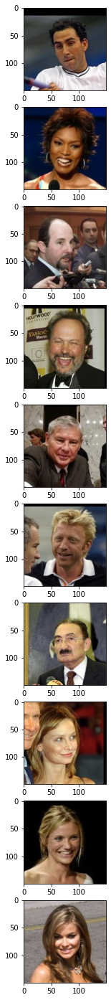

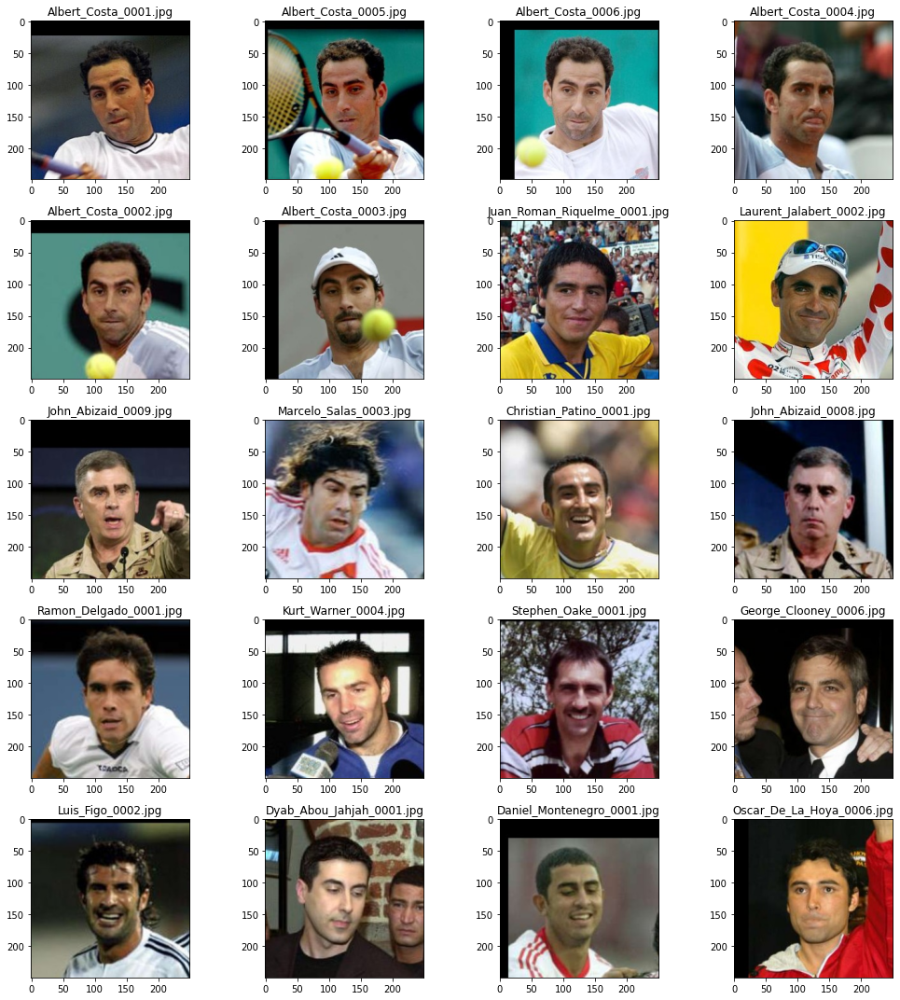

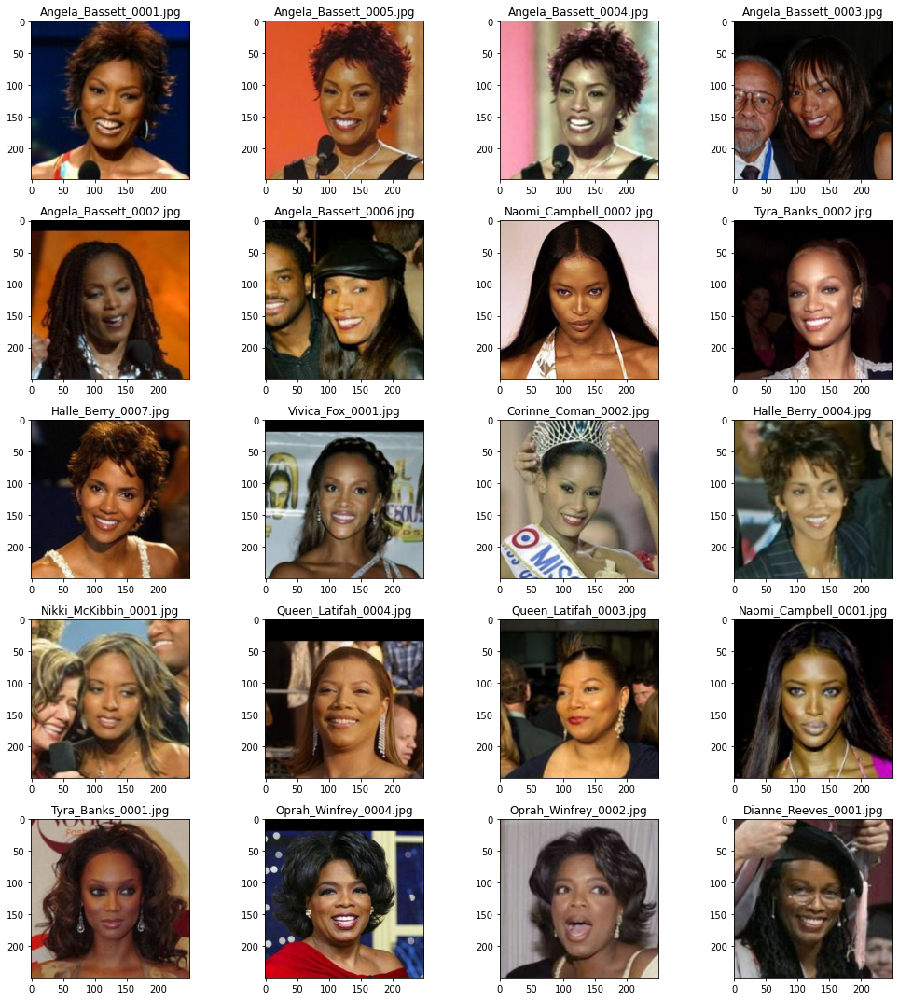

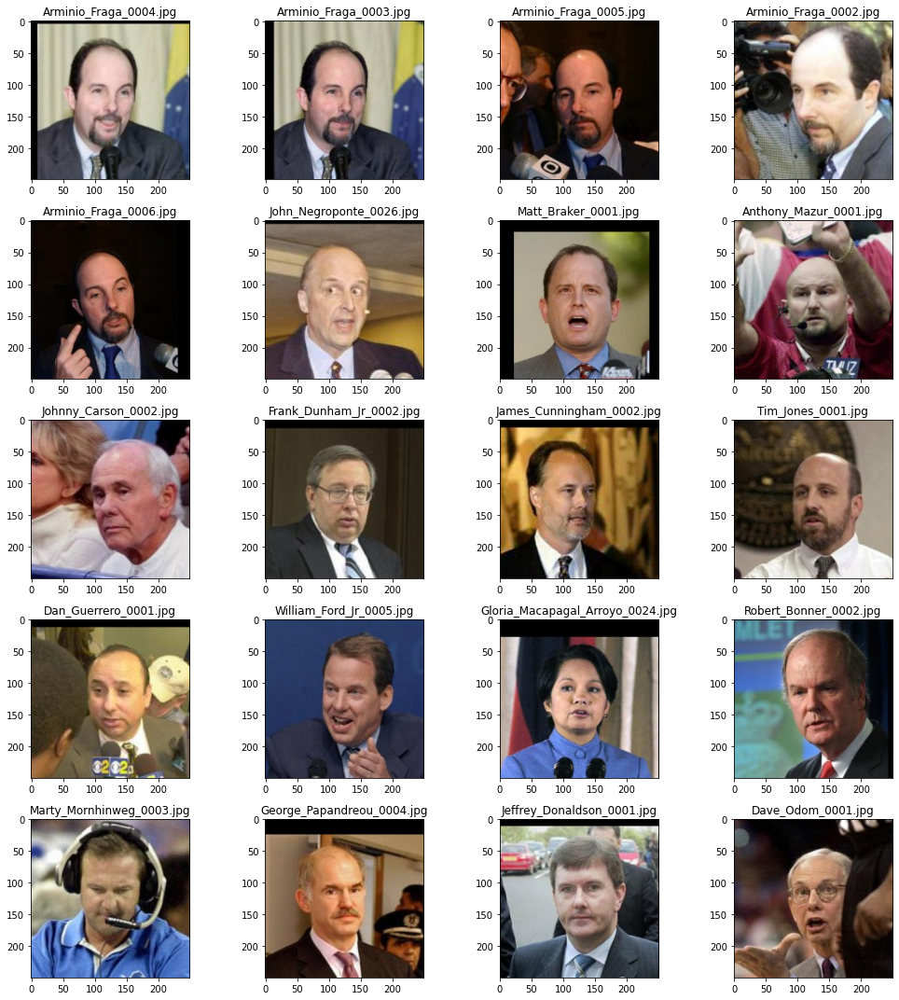

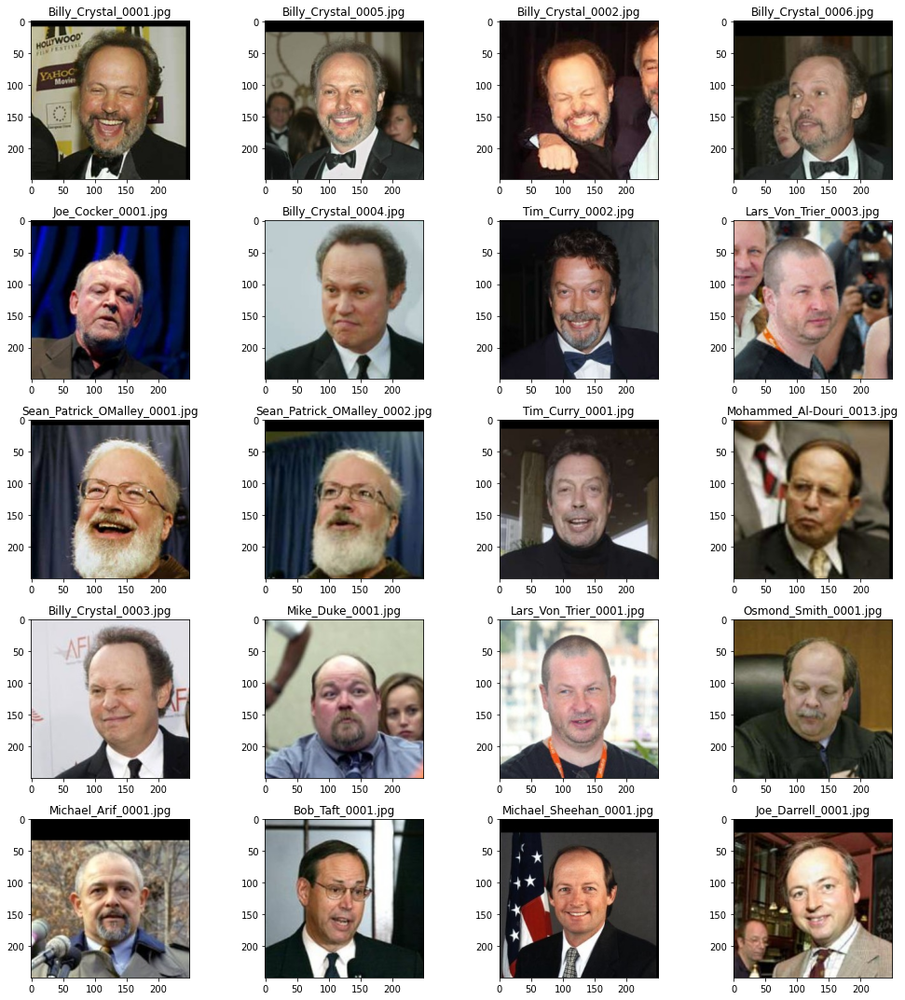

...

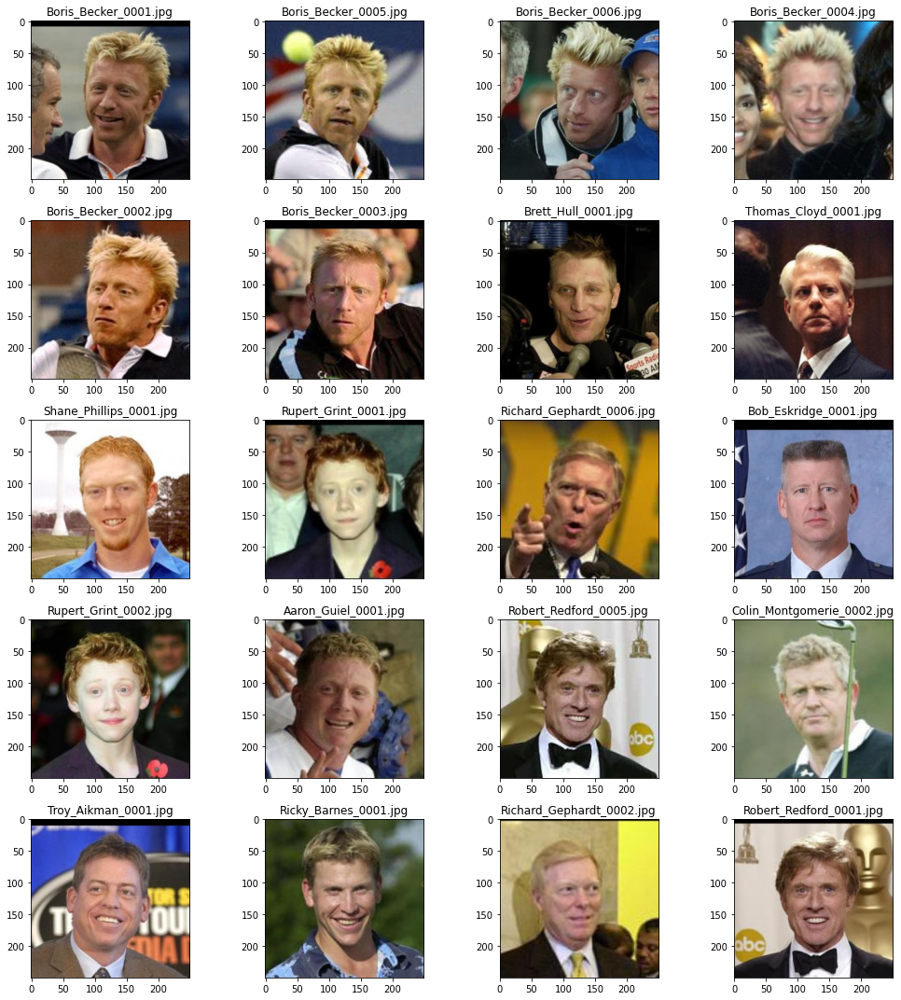

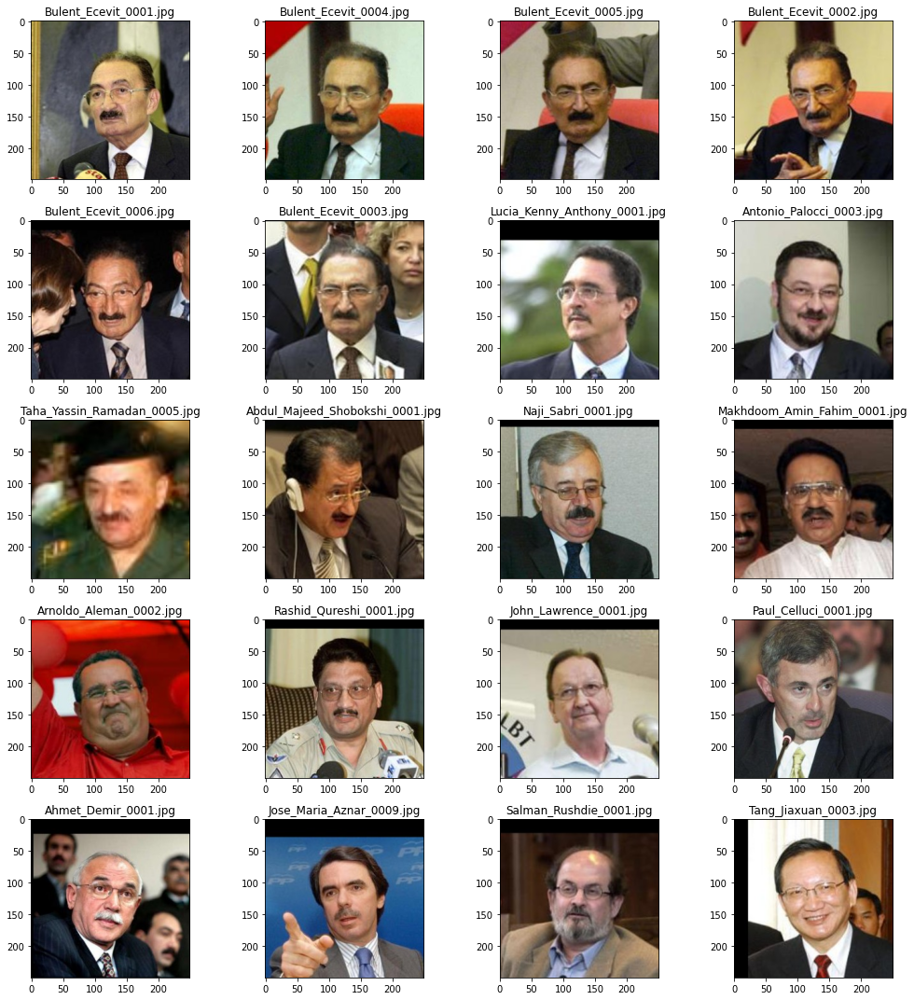

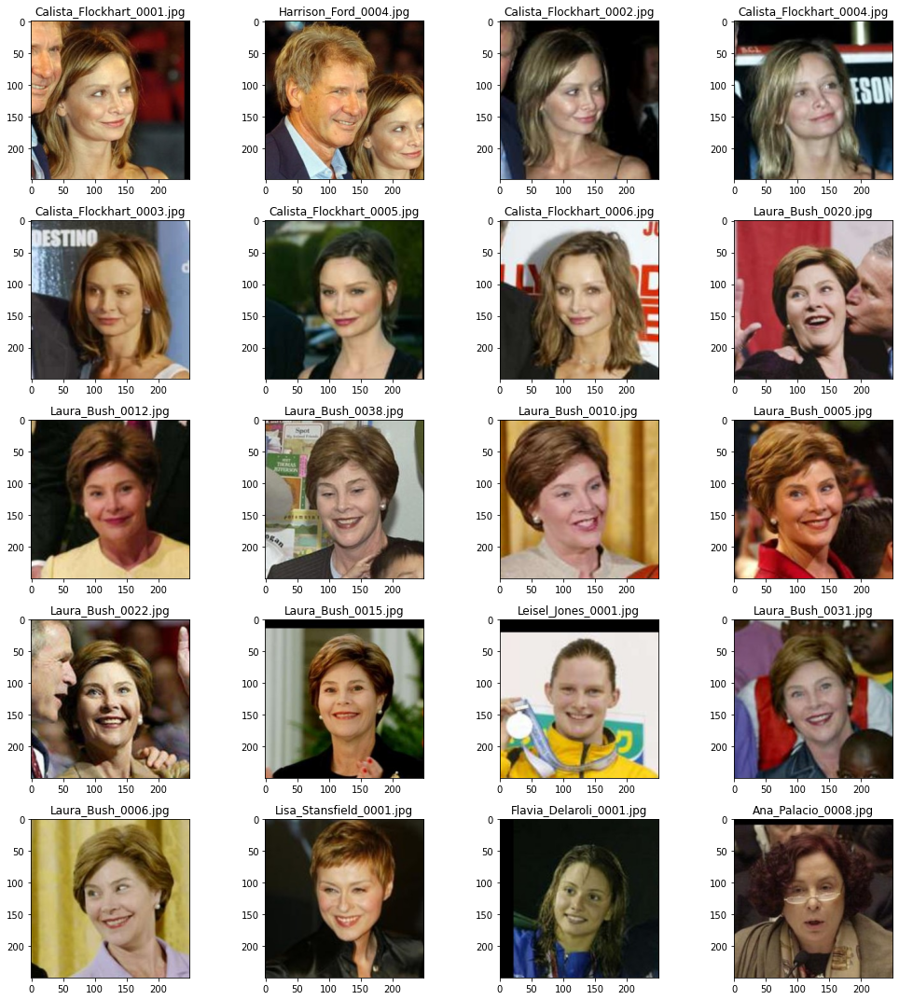

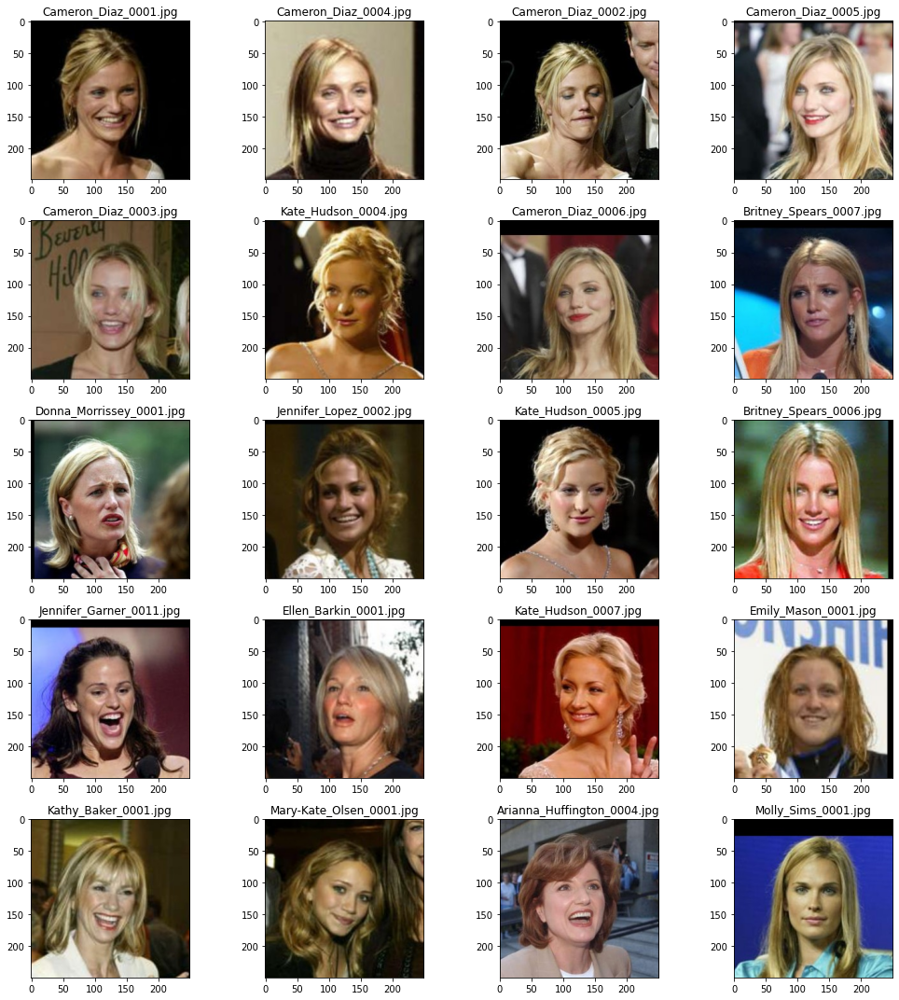

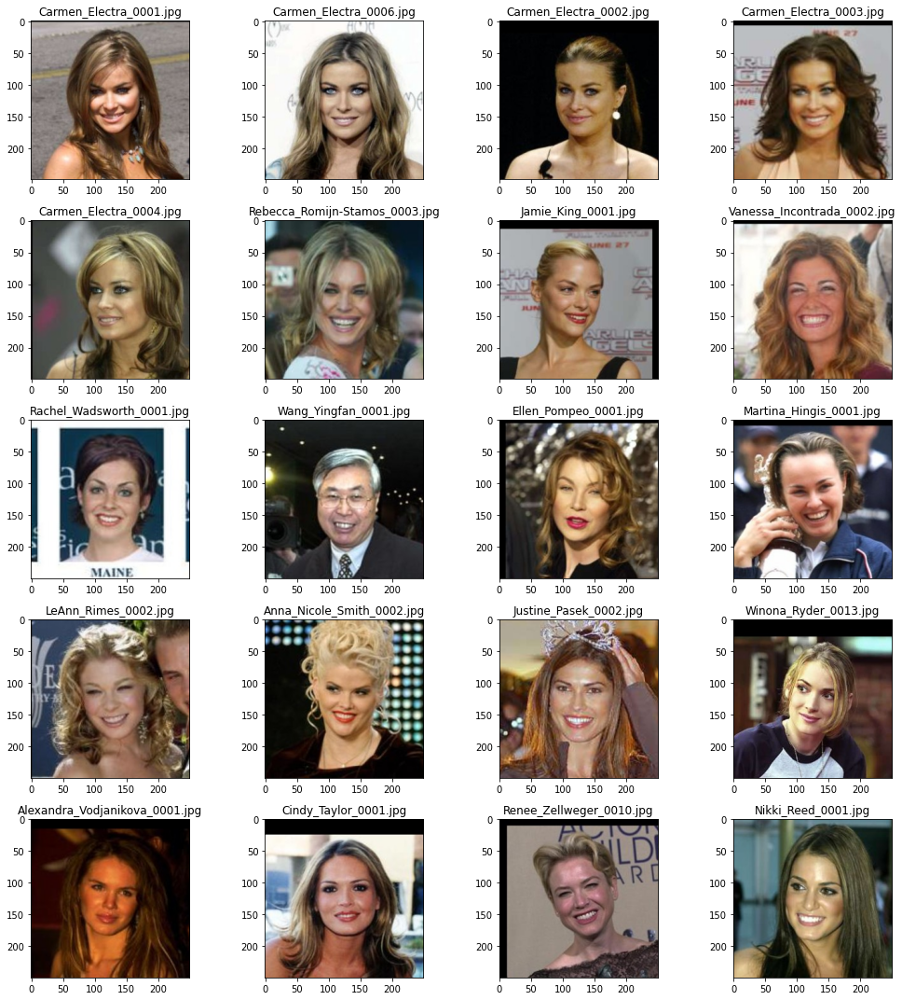

In [43]:
query = os.listdir('inputs')

index = 0

figure, axis = plt.subplots(10, 1, figsize=(25,25))

axiss = axis.ravel()

for _, top_results in data.items():
    
    current_query = query[index]
    query_img = mpimg.imread('inputs/' + current_query)
    
    axiss[index].imshow(query_img)
    
    fig, axs = plt.subplots(5, 4, figsize=(15,15))
    axis = axs.ravel()
    axis_index = 0
    
    for key, value in top_results.items():
        label, image_no = key.split('_')
        name = labels[labels.Name == int(label)]['Label'].values[0]
        
        output_image = mpimg.imread('LFW' + '/' + name + '/' + name + '_' + image_no + '.jpg')
        
        axis[axis_index].imshow(output_image)
        axis[axis_index].set_title(name + '_' + image_no + '.jpg')
        
        axis_index += 1
        plt.tight_layout()
    
    index += 1

plt.show()
        

In [7]:
def query_given(current_query):
    query_img = mpimg.imread('inputs/' + current_query)
    plt.imshow(query_img)
    plt.title(current_query)
    
    os.mkdir('output/' + current_query)
    os.mkdir('output/' + current_query + '/' + 'query')
    plt.savefig('output/' + current_query + '/' + 'query/' + current_query + '.jpg')
    

In [8]:
def query_results(top_results, current_query):
    fig, axs = plt.subplots(5, 4, figsize=(15,15))
    axis = axs.ravel()
    axis_index = 0
    
    for key, value in top_results.items():
        label, image_no = key.split('_')
        name = labels[labels.Name == int(label)]['Label'].values[0]
        
        output_image = mpimg.imread('LFW' + '/' + name + '/' + name + '_' + image_no + '.jpg')
        
        axis[axis_index].imshow(output_image)
        axis[axis_index].set_title(name + '_' + image_no + '.jpg')
        
        axis_index += 1
        plt.tight_layout()
        
    fig.savefig('output/' + current_query + '/' + 'output.jpg')

In [11]:
results = dict()
index = 0
for _, top_results in data.items():
    results[index] = top_results
    index += 1

In [12]:
query = os.listdir('inputs')

## Alber Costa 0001

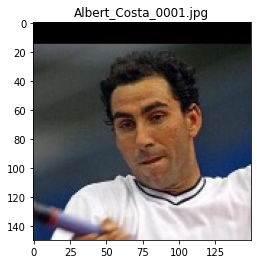

In [13]:
query_given(query[0])

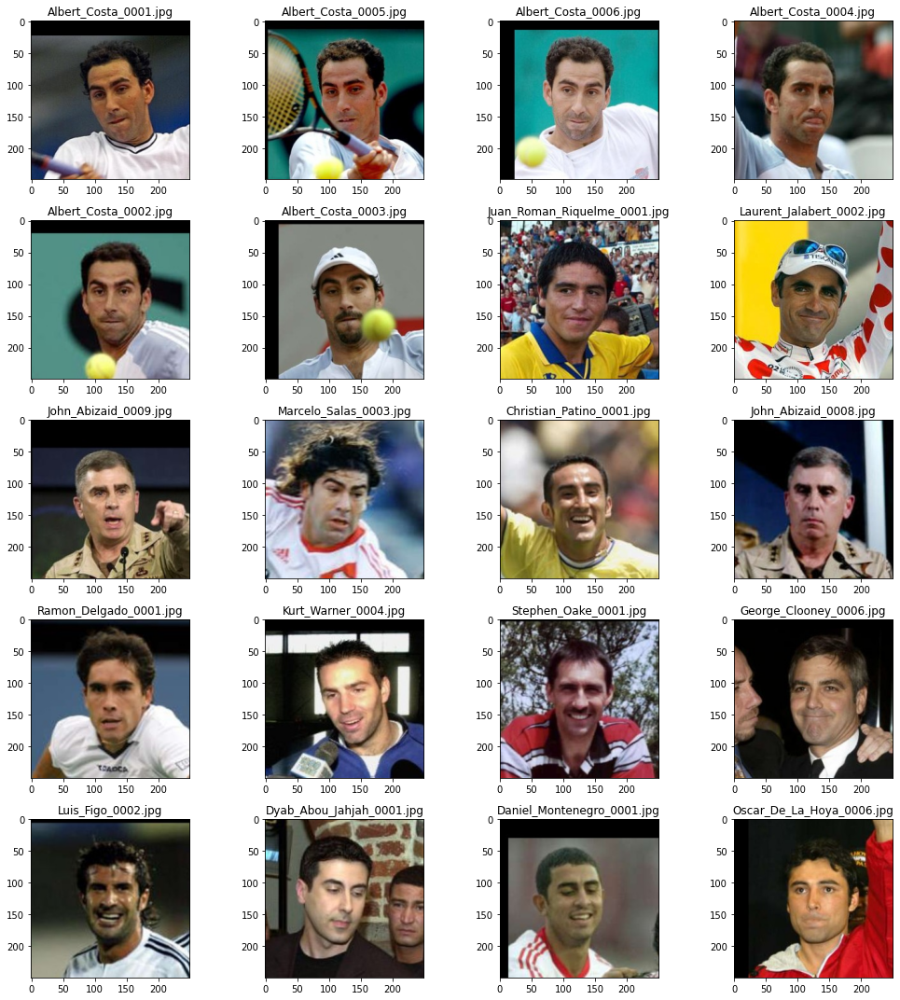

In [14]:
query_results(results[0], query[0])

## Angela Basset

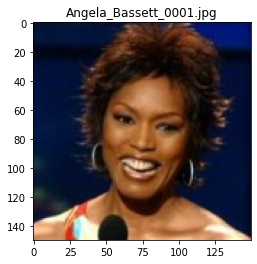

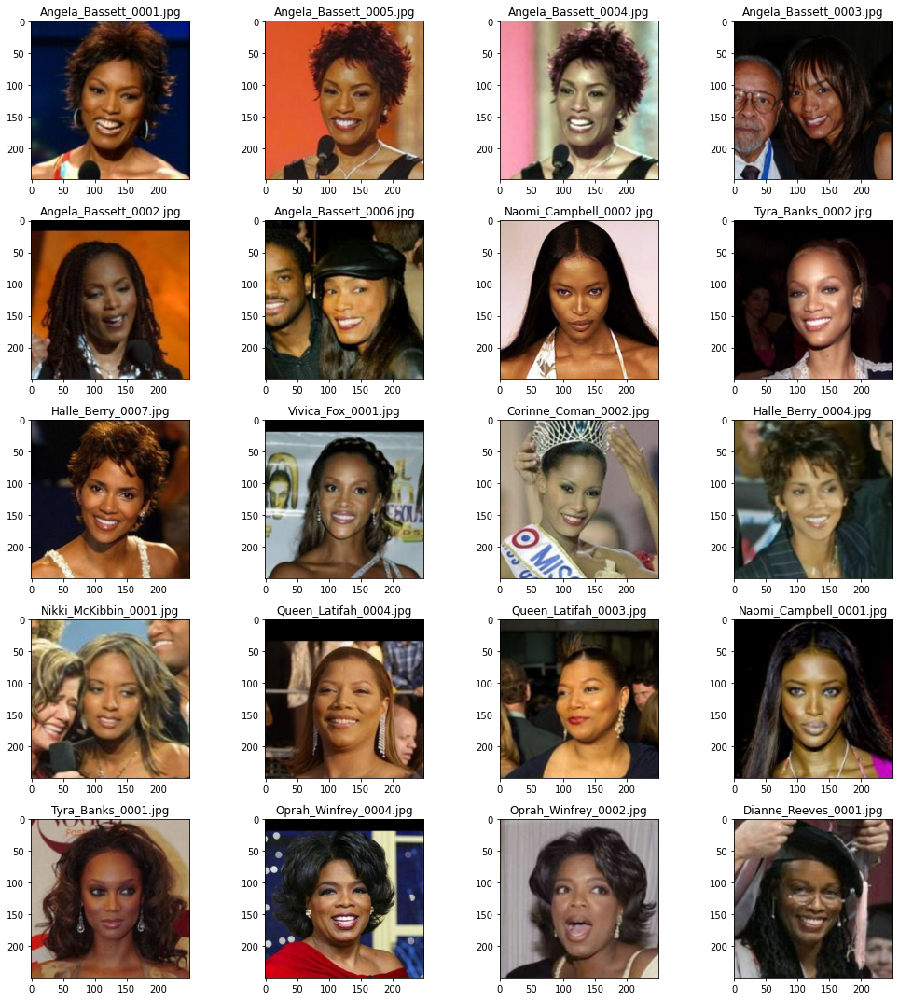

In [15]:
query_given(query[1])
query_results(results[1], query[1])

## Arminio Fraga

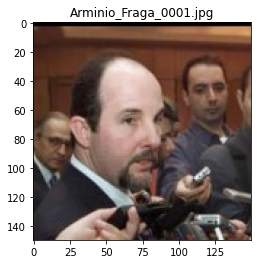

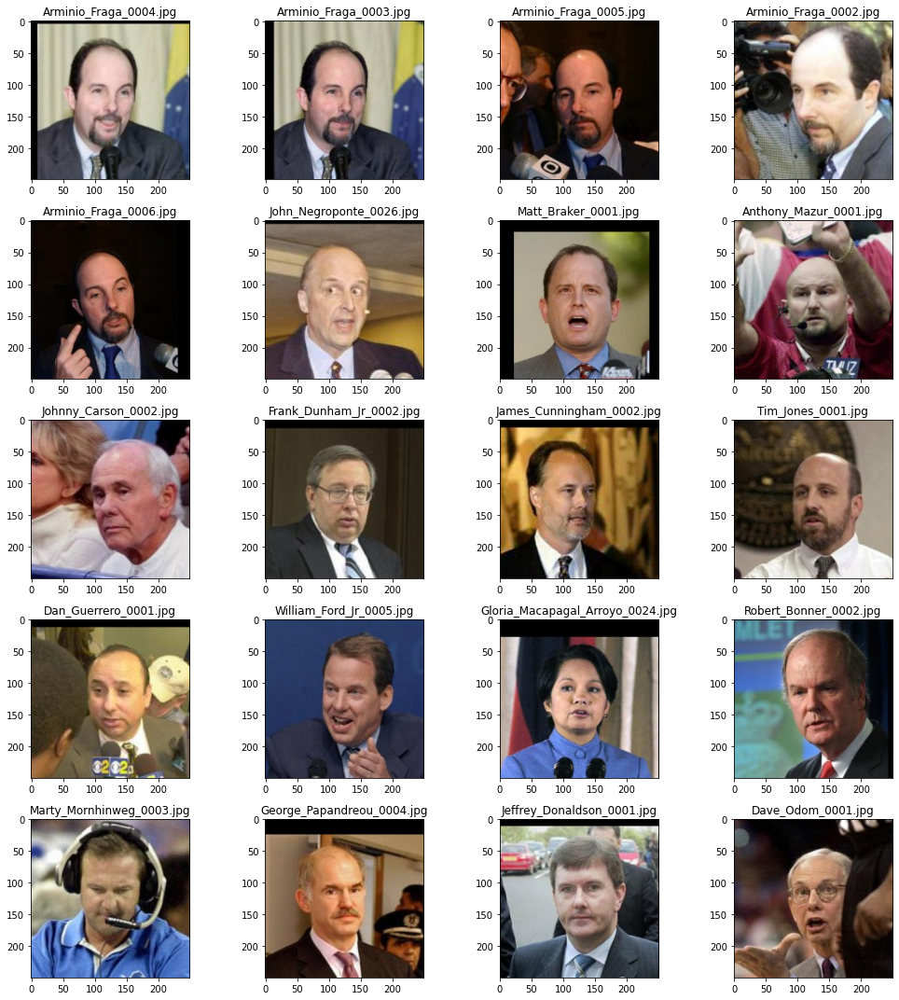

In [16]:
query_given(query[2])
query_results(results[2], query[2])

## Billy Crystal

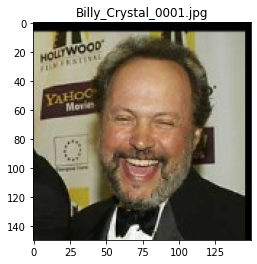

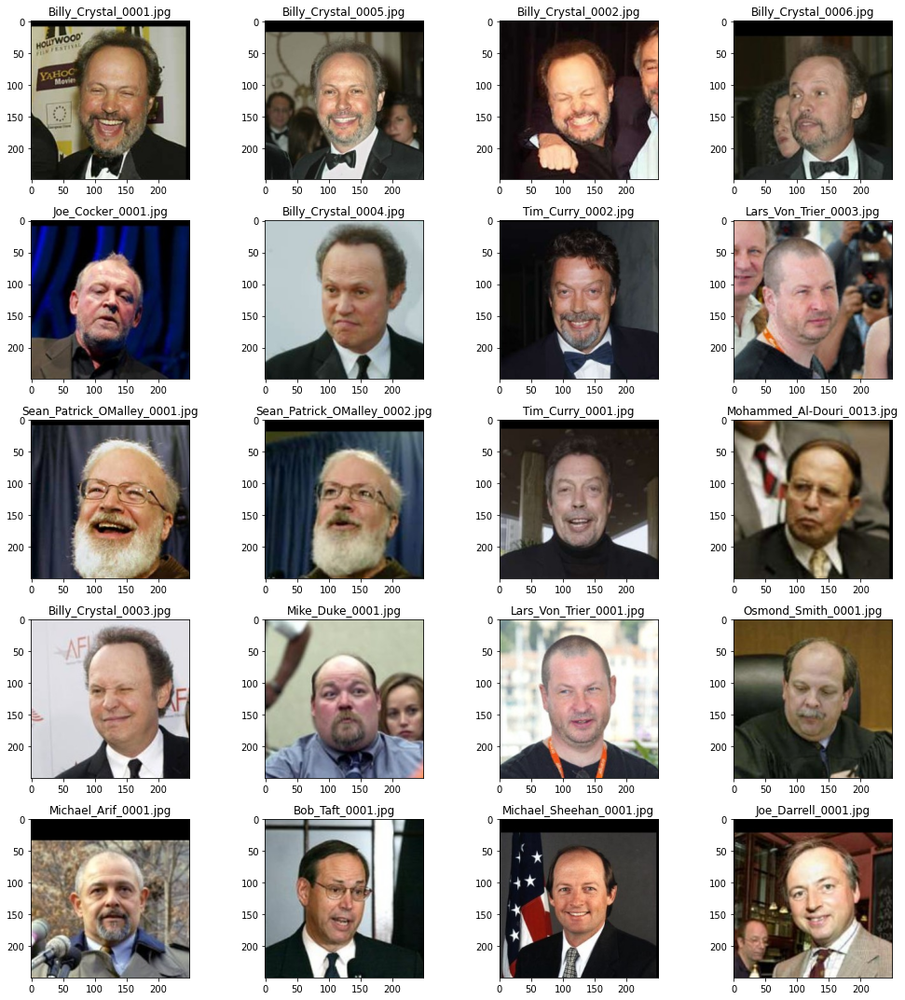

In [17]:
query_given(query[3])
query_results(results[3], query[3])

## Bob Graham

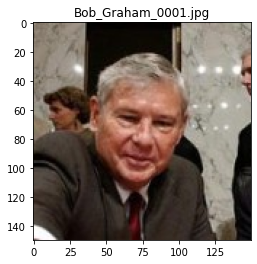

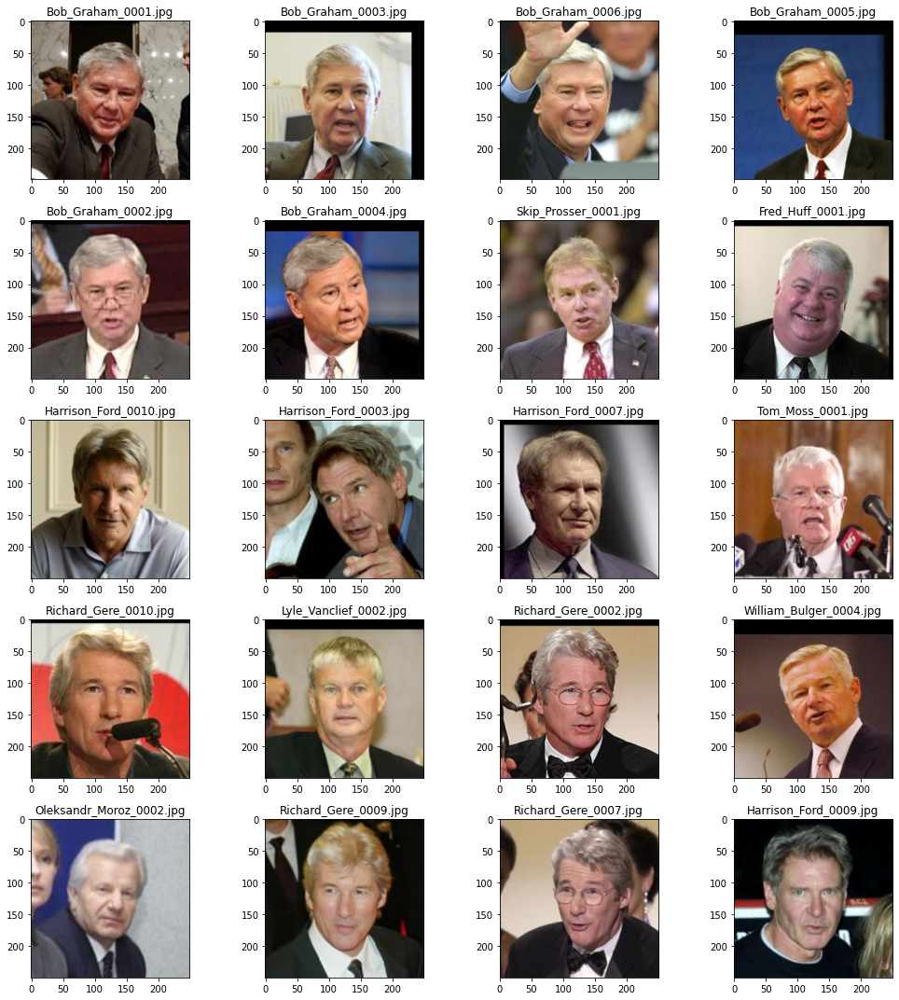

In [18]:
query_given(query[4])
query_results(results[4], query[4])

## Boris Becker

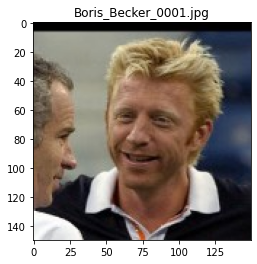

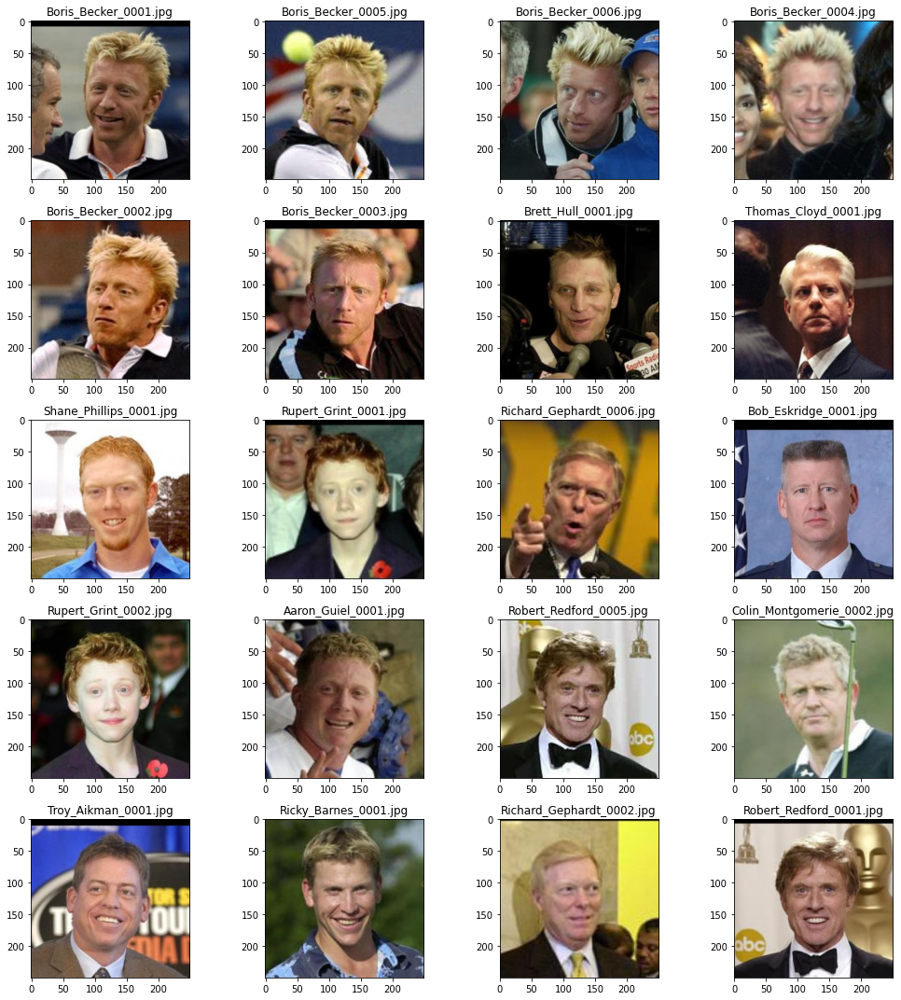

In [19]:
query_given(query[5])
query_results(results[5], query[5])

## Bulent Ecevit

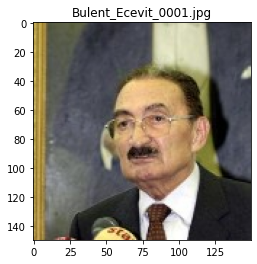

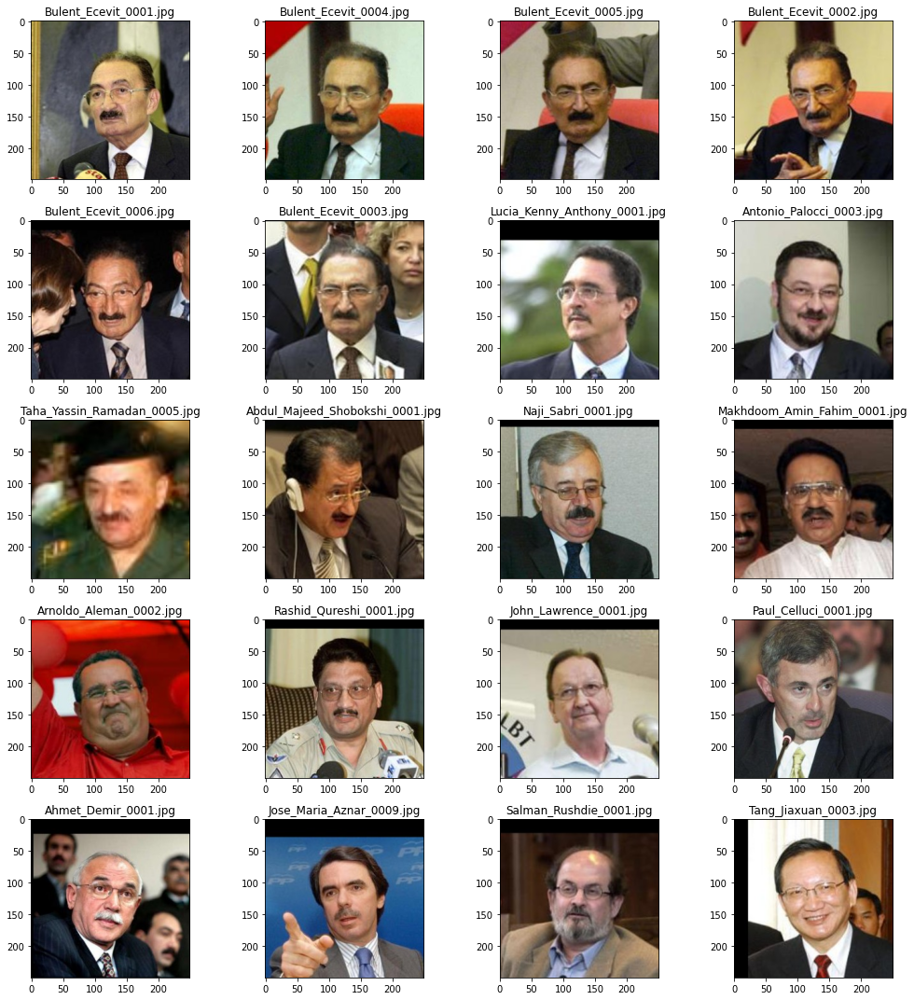

In [20]:
query_given(query[6])
query_results(results[6], query[6])

## Calista Flockhart

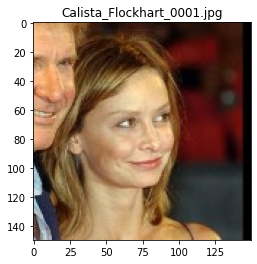

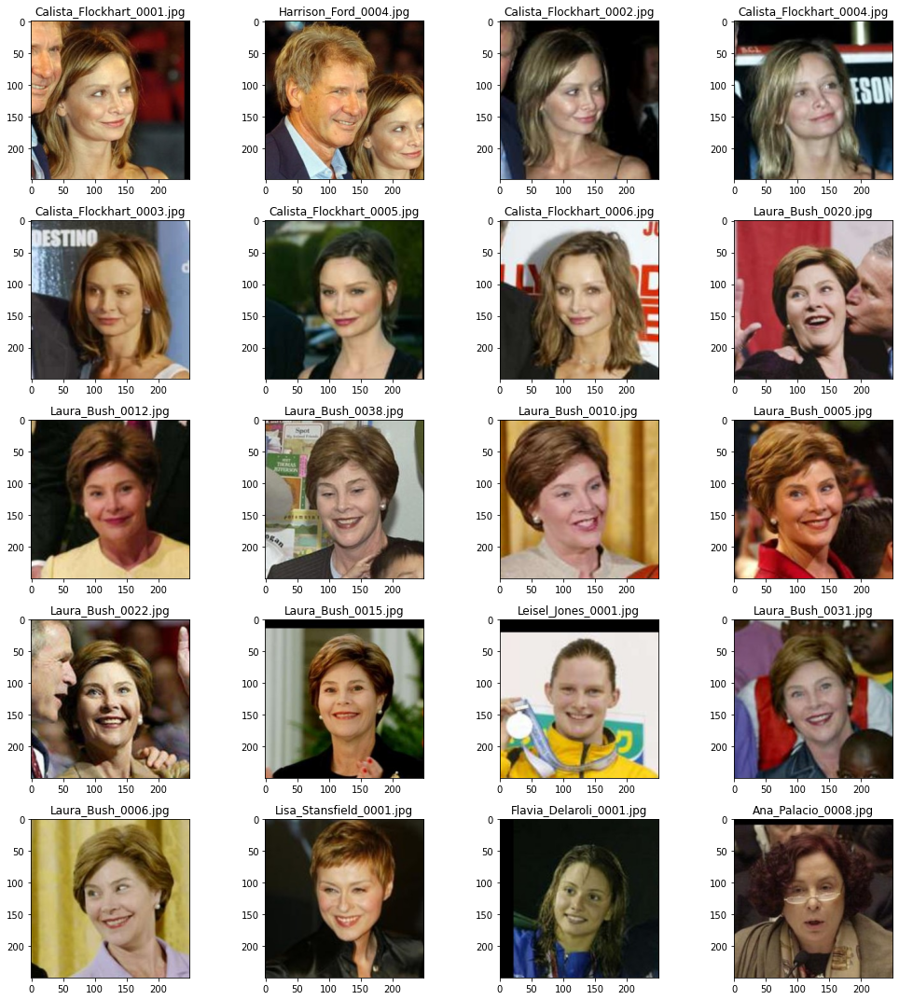

In [21]:
query_given(query[7])
query_results(results[7], query[7])

## Cameron Diaz

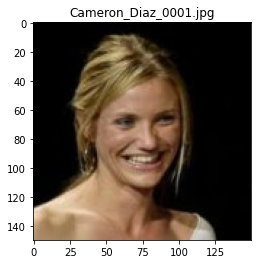

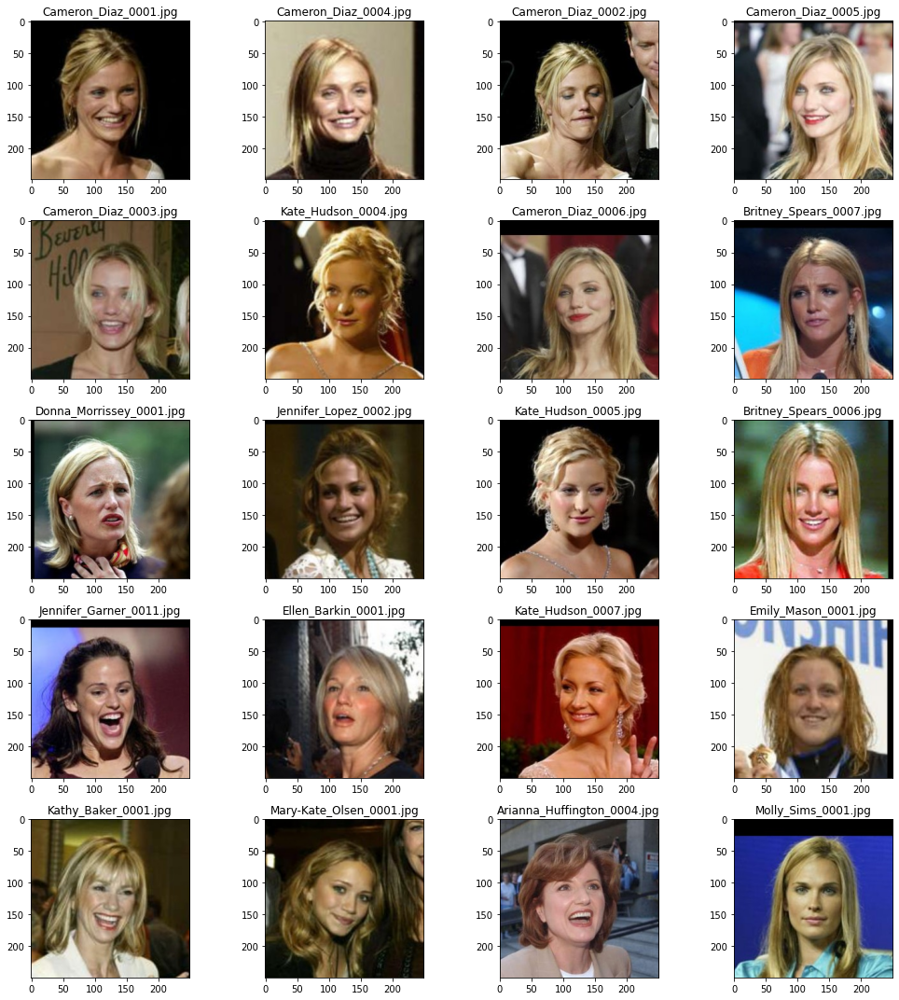

In [22]:
query_given(query[8])
query_results(results[8], query[8])

## Carmen Electra

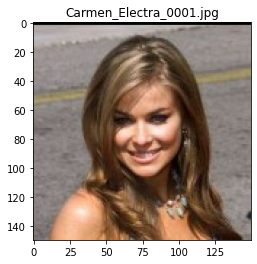

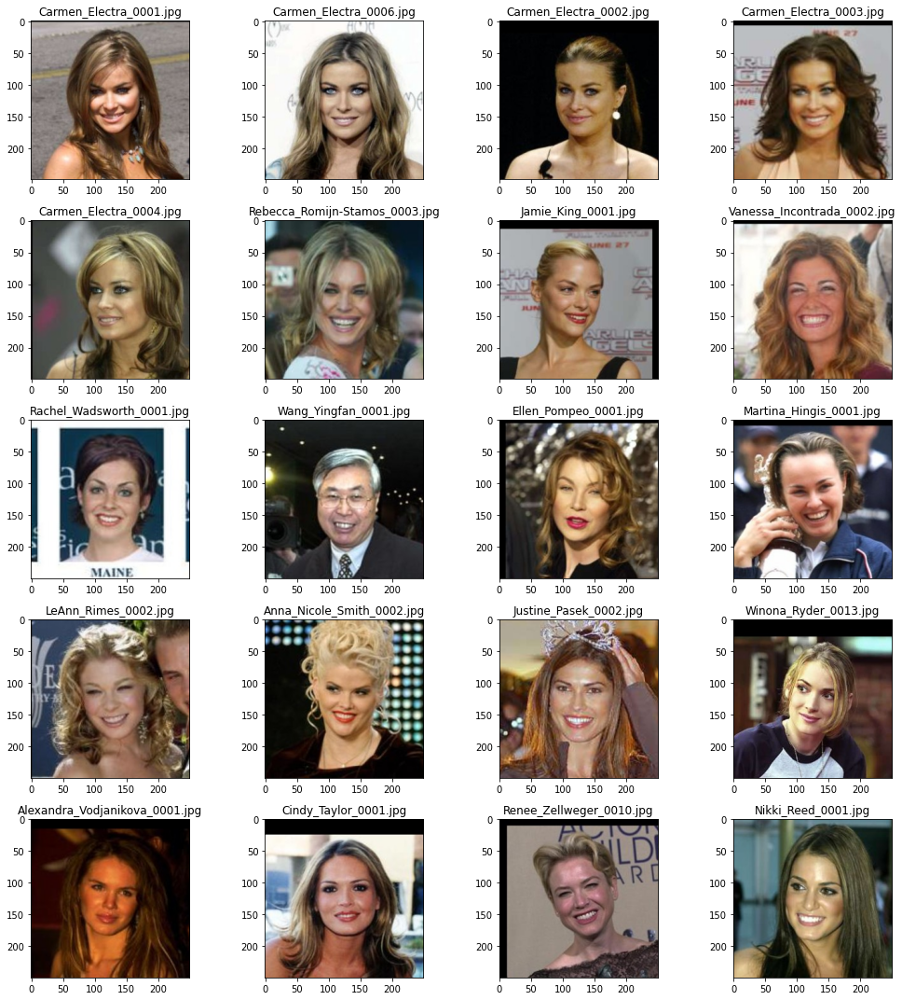

In [23]:
query_given(query[9])
query_results(results[9], query[9])